## Importing libraries

In [1]:
#Basic Functionalities:
import os
import pandas as pd
import numpy as np

#PyTorch
import torchvision
import torch
import timm
from torch import optim
from fastai.vision.learner import create_body
from torchvision.models.resnet import resnet18
from fastai.vision.models.unet import DynamicUnet
from torch.utils.tensorboard import SummaryWriter
from torchvision.transforms.functional import crop
from torch.utils.data import Dataset
from torch import nn
from torchinfo import summary

#Metrics
import seaborn as sb
import matplotlib.pyplot as plt

# Misc.
import PIL
import cv2
import time
import warnings
from skimage.color import rgb2lab, lab2rgb
from tqdm.notebook import tqdm_notebook

warnings.filterwarnings("ignore")

#Selecting device
device="cuda" if torch.cuda.is_available() else "cpu"

print(f"Using {device}")

Using cuda


## Checking sample images

In [2]:
im1= cv2.imread("../Dataset/subset_1/manga1/train/bw/01.jpg", cv2.IMREAD_GRAYSCALE)
im2=cv2.imread(("sample_image_02.png"),cv2.IMREAD_COLOR)

im1 = cv2.cvtColor(im1, cv2.COLOR_GRAY2RGB)
im2 = cv2.cvtColor(im2, cv2.COLOR_BGR2RGB)

print(im1.shape)
print(im2.shape)

(2359, 1665, 3)
(2448, 1665, 3)


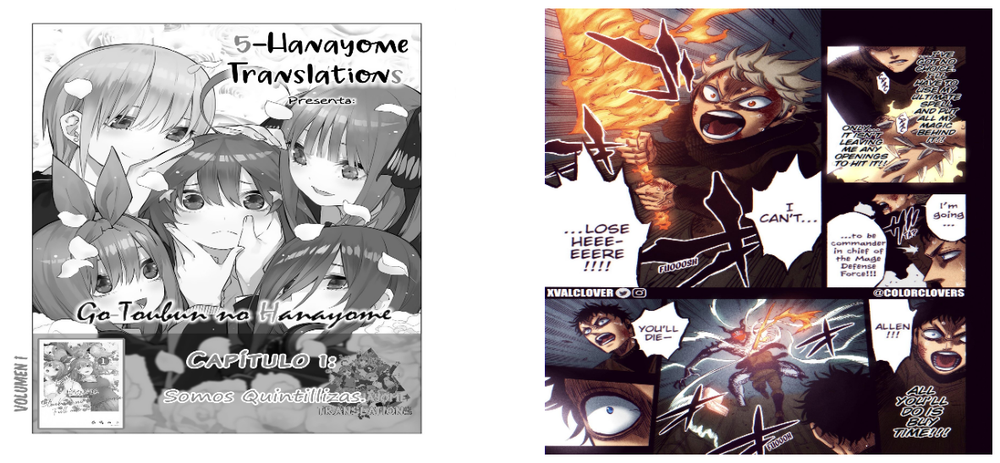

In [3]:
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis(False)
plt.imshow(cv2.resize(im1,(572,572)))
plt.subplot(1,2,2)
plt.axis(False)
plt.imshow(cv2.resize(im2,(572,572)))

## Dataset Creation

In [4]:
class dataset(Dataset):
    def __init__(self, color_dir: str):
        self.color_images=[]

        for i in os.listdir(color_dir):
            self.color_images.append(color_dir+"/"+i)
            
        self.color_images.sort()
        
    def __len__(self):
        return len(self.color_images)

    def __getitem__(self,index):

        self.transforms = torchvision.transforms.Compose([
                torchvision.transforms.Resize((256, 256),  PIL.Image.BICUBIC),
                torchvision.transforms.RandomHorizontalFlip(), # A little data augmentation!
            ])
        img = PIL.Image.open(self.color_images[index]).convert("RGB")
        img = self.transforms(img)
        img = np.array(img)
        img_lab = rgb2lab(img).astype("float32") # Converting RGB to L*a*b
        img_lab = torchvision.transforms.ToTensor()(img_lab)
        
        L = img_lab[[0], ...] / 50. - 1. # Between -1 and 1
        ab = img_lab[[1, 2], ...] / 110. # Between -1 and 1

        return {"L":L, "ab":ab}
        

In [5]:
BATCH_SIZE=8

train_ds=dataset("../Dataset/subset_2/color1/")
test_ds=dataset("../Dataset/ds/blackclover/colored/")

train_loader=torch.utils.data.DataLoader(train_ds,BATCH_SIZE)
test_loader=torch.utils.data.DataLoader(test_ds,BATCH_SIZE)

#### Testing loaders

In [6]:
def lab_to_rgb(L, ab):
    """
    Takes a batch of images
    """
    
    L = (L + 1.) * 50.
    ab = ab * 110.

    
    Lab = torch.cat([L, ab], dim=1).permute(0, 2, 3, 1).cpu().numpy()
    rgb_imgs = []
    for img in Lab:
        img_rgb = lab2rgb(img)
        rgb_imgs.append(img_rgb)
    return np.stack(rgb_imgs, axis=0)


def visualize_dataset(loader: torch.utils.data.DataLoader = train_loader,size=(12,8)):
    plt.figure(figsize=size)
    i=1
    data=next(iter(loader))
     
    rand_ind=torch.randint(0,BATCH_SIZE-1,size=(1,)).item()
    
    bw=data["L"]
    color=data["ab"]
    
    full_img=lab_to_rgb(bw,color)
    
    while(i<4):
        plt.subplot(2,3,i)
        plt.axis(False)
        plt.imshow(bw[i].permute((1,2,0)),cmap="gray")
        plt.subplot(2,3,i+3)
        plt.axis(False)
        plt.imshow(full_img[i])
        i+=1



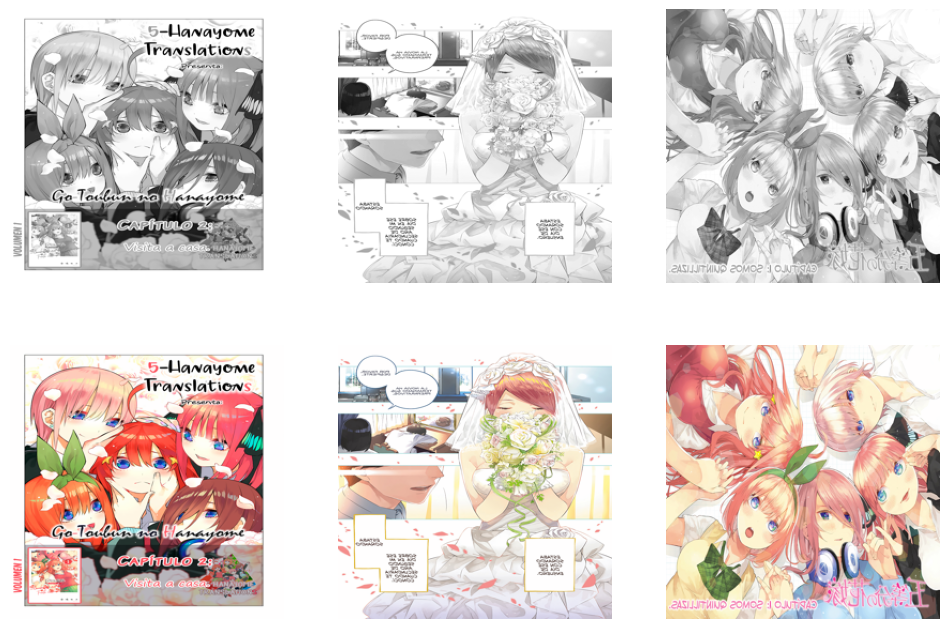

In [7]:
visualize_dataset(train_loader)

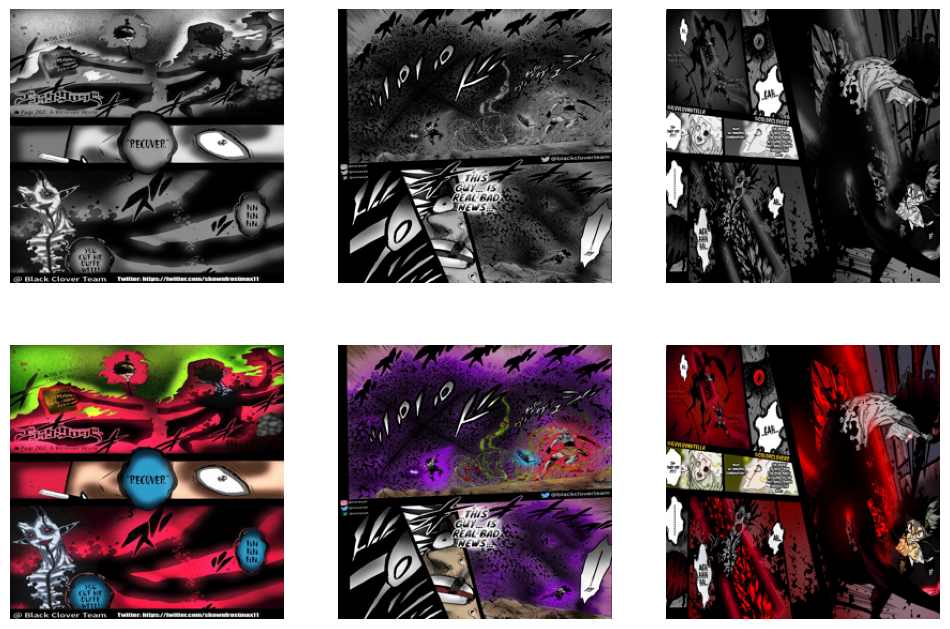

In [8]:
visualize_dataset(test_loader)

## Model Formation

### Discriminator

In [9]:
class PatchDiscriminator(nn.Module):
    def __init__(self, input_c, num_filters=64, n_down=3):
        super().__init__()
        model = [self.get_layers(input_c, num_filters, norm=False)]
        model += [self.get_layers(num_filters * 2 ** i, num_filters * 2 ** (i + 1), s=1 if i == (n_down-1) else 2) 
                          for i in range(n_down)] # the 'if' statement is taking care of not using
                                                  # stride of 2 for the last block in this loop
        model += [self.get_layers(num_filters * 2 ** n_down, 1, s=1, norm=False, act=False)] # Make sure to not use normalization or
                                                                                             # activation for the last layer of the model
        self.model = nn.Sequential(*model)                                                   
        
    def get_layers(self, ni, nf, k=4, s=2, p=1, norm=True, act=True): # when needing to make some repeatitive blocks of layers,
        layers = [nn.Conv2d(ni, nf, k, s, p, bias=not norm)]          # it's always helpful to make a separate method for that purpose
        if norm: layers += [nn.BatchNorm2d(nf)]
        if act: layers += [nn.LeakyReLU(0.2, True)]
        return nn.Sequential(*layers)
    
    def forward(self, x):
        return self.model(x)


PatchDiscriminator(3)

discriminator = PatchDiscriminator(3)
dummy_input = torch.randn(16, 3, 256, 256) # batch_size, channels, size, size
out = discriminator(dummy_input)
out.shape

torch.Size([16, 1, 30, 30])

### GAN Loss function

In [10]:
class GANLoss(nn.Module):
    def __init__(self, gan_mode='vanilla', real_label=1.0, fake_label=0.0):
        super().__init__()
        self.register_buffer('real_label', torch.tensor(real_label))
        self.register_buffer('fake_label', torch.tensor(fake_label))
        if gan_mode == 'vanilla':
            self.loss = nn.BCEWithLogitsLoss()
        elif gan_mode == 'lsgan':
            self.loss = nn.MSELoss()
    
    def get_labels(self, preds, target_is_real):
        if target_is_real:
            labels = self.real_label
        else:
            labels = self.fake_label
        return labels.expand_as(preds)
    
    def __call__(self, preds, target_is_real):
        labels = self.get_labels(preds, target_is_real)
        loss = self.loss(preds, labels)
        return loss

### Weight initializing

In [11]:
def init_weights(net, init='norm', gain=0.02):
    
    def init_func(m):
        classname = m.__class__.__name__
        if hasattr(m, 'weight') and 'Conv' in classname:
            if init == 'norm':
                nn.init.normal_(m.weight.data, mean=0.0, std=gain)
            elif init == 'xavier':
                nn.init.xavier_normal_(m.weight.data, gain=gain)
            elif init == 'kaiming':
                nn.init.kaiming_normal_(m.weight.data, a=0, mode='fan_in')
            
            if hasattr(m, 'bias') and m.bias is not None:
                nn.init.constant_(m.bias.data, 0.0)
        elif 'BatchNorm2d' in classname:
            nn.init.normal_(m.weight.data, 1., gain)
            nn.init.constant_(m.bias.data, 0.)
            
    net.apply(init_func)
    print(f"model initialized with {init} initialization")
    return net

def init_model(model, device):
    model = model.to(device)
    model = init_weights(model)
    return model

In [12]:
class AverageMeter:
    def __init__(self):
        self.reset()
        
    def reset(self):
        self.count, self.avg, self.sum = [0.] * 3
    
    def update(self, val, count=1):
        self.count += count
        self.sum += count * val
        self.avg = self.sum / self.count

def create_loss_meters():
    loss_D_fake = AverageMeter()
    loss_D_real = AverageMeter()
    loss_D = AverageMeter()
    loss_G_GAN = AverageMeter()
    loss_G_L1 = AverageMeter()
    loss_G = AverageMeter()
    
    return {'loss_D_fake': loss_D_fake,
            'loss_D_real': loss_D_real,
            'loss_D': loss_D,
            'loss_G_GAN': loss_G_GAN,
            'loss_G_L1': loss_G_L1,
            'loss_G': loss_G}

def update_losses(model, loss_meter_dict, count):
    for loss_name, loss_meter in loss_meter_dict.items():
        loss = getattr(model, loss_name)
        loss_meter.update(loss.item(), count=count)

def lab_to_rgb(L, ab):
    """
    Takes a batch of images
    """
    
    L = (L + 1.) * 50.
    ab = ab * 110.
    Lab = torch.cat([L, ab], dim=1).permute(0, 2, 3, 1).cpu().numpy()
    rgb_imgs = []
    for img in Lab:
        img_rgb = lab2rgb(img)
        rgb_imgs.append(img_rgb)
    return np.stack(rgb_imgs, axis=0)
    
def visualize(model, data, save=True):
    model.net_G.eval()
    with torch.no_grad():
        model.setup_input(data)
        model.forward()
    model.net_G.train()
    fake_color = model.fake_color.detach()
    real_color = model.ab
    L = model.L
    fake_imgs = lab_to_rgb(L, fake_color)
    real_imgs = lab_to_rgb(L, real_color)
    fig = plt.figure(figsize=(25, 15))
    for i in range(5):
        ax = plt.subplot(3, 5, i + 1)
        ax.imshow(L[i][0].cpu(), cmap='gray')
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 5)
        ax.imshow(fake_imgs[i])
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 10)
        ax.imshow(real_imgs[i])
        ax.axis("off")
    plt.show()
    if save:
        fig.savefig(f"colorization_{time.time()}.png")
        
def log_results(loss_meter_dict):
    for loss_name, loss_meter in loss_meter_dict.items():
        print(f"{loss_name}: {loss_meter.avg:.5f}")

### Main Model

In [13]:
class MainModel(nn.Module):
    def __init__(self, net_G=None, lr_G=2e-4, lr_D=2e-4, 
                 beta1=0.5, beta2=0.999, lambda_L1=100.):
        super().__init__()
        
        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        self.lambda_L1 = lambda_L1
        
        if net_G is None:
            self.net_G = init_model(Unet(input_c=1, output_c=2, n_down=8, num_filters=64), self.device)
        else:
            self.net_G = net_G.to(self.device)
        self.net_D = init_model(PatchDiscriminator(input_c=3, n_down=3, num_filters=64), self.device)
        self.GANcriterion = GANLoss(gan_mode='vanilla').to(self.device)
        self.L1criterion = nn.L1Loss()
        self.opt_G = optim.Adam(self.net_G.parameters(), lr=lr_G, betas=(beta1, beta2))
        self.opt_D = optim.Adam(self.net_D.parameters(), lr=lr_D, betas=(beta1, beta2))
    
    def set_requires_grad(self, model, requires_grad=True):
        for p in model.parameters():
            p.requires_grad = requires_grad
        
    def setup_input(self, data):
        self.data=data
        self.L = data['L'].to(self.device)
        self.ab = data['ab'].to(self.device)
        
    def forward(self, data=None):
        if(data is not None):
            self.L = data['L'].to(self.device)
            self.ab = data['ab'].to(self.device)
            self.fake_color = self.net_G(self.L)
            return self.fake_color
        else:
            self.fake_color = self.net_G(self.L)
    
    def backward_D(self):
        fake_image = torch.cat([self.L, self.fake_color], dim=1)
        fake_preds = self.net_D(fake_image.detach())
        self.loss_D_fake = self.GANcriterion(fake_preds, False)
        real_image = torch.cat([self.L, self.ab], dim=1)
        real_preds = self.net_D(real_image)
        self.loss_D_real = self.GANcriterion(real_preds, True)
        self.loss_D = (self.loss_D_fake + self.loss_D_real) * 0.5
        self.loss_D.backward()
    
    def backward_G(self):
        fake_image = torch.cat([self.L, self.fake_color], dim=1)
        fake_preds = self.net_D(fake_image)
        self.loss_G_GAN = self.GANcriterion(fake_preds, True)
        self.loss_G_L1 = self.L1criterion(self.fake_color, self.ab) * self.lambda_L1
        self.loss_G = self.loss_G_GAN + self.loss_G_L1
        self.loss_G.backward()
    
    def optimize(self):
        self.forward()
        self.net_D.train()
        self.set_requires_grad(self.net_D, True)
        self.opt_D.zero_grad()
        self.backward_D()
        self.opt_D.step()
        
        self.net_G.train()
        self.set_requires_grad(self.net_D, False)
        self.opt_G.zero_grad()
        self.backward_G()
        self.opt_G.step()

### Model Building Functions

In [14]:
idk=resnet18()

In [15]:
idk.conv1=nn.Conv2d(1, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)

In [16]:
idk=nn.Sequential(*list(idk.children())[:-2])

In [21]:
idk(torch.rand((32,1,256,256))).shape

torch.Size([32, 512, 8, 8])

In [18]:
 class UNet(nn.Module):
    def __init__(self):
        super().__init__()
        
        # Encoder
        # In the encoder, convolutional layers with the Conv2d function are used to extract features from the input image. 
        # Each block in the encoder consists of two convolutional layers followed by a max-pooling layer, with the exception of the last block which does not include a max-pooling layer.
        # -------
        # input: 572x572x3
        self.e11 = nn.Conv2d(1, 64, kernel_size=3, padding=0) # output: 570x570x64
        self.e12 = nn.Conv2d(64, 64, kernel_size=3, padding=0) # output: 568x568x64
        self.pool1 = nn.MaxPool2d(kernel_size=2, stride=2) # output: 284x284x64

        # input: 284x284x64
        self.e21 = nn.Conv2d(64, 128, kernel_size=3, padding=0) # output: 282x282x128
        self.e22 = nn.Conv2d(128, 128, kernel_size=3, padding=0) # output: 280x280x128
        self.pool2 = nn.MaxPool2d(kernel_size=2, stride=2) # output: 140x140x128

        # input: 140x140x128
        self.e31 = nn.Conv2d(128, 256, kernel_size=3, padding=0) # output: 138x138x256
        self.e32 = nn.Conv2d(256, 256, kernel_size=3, padding=0) # output: 136x136x256
        self.pool3 = nn.MaxPool2d(kernel_size=2, stride=2) # output: 68x68x256

        # input: 68x68x256
        self.e41 = nn.Conv2d(256, 512, kernel_size=3, padding=0) # output: 66x66x512
        self.e42 = nn.Conv2d(512, 512, kernel_size=3, padding=0) # output: 64x64x512
        self.pool4 = nn.MaxPool2d(kernel_size=2, stride=2) # output: 32x32x512

        # input: 32x32x512
        self.e51 = nn.Conv2d(512, 1024, kernel_size=3, padding=0) # output: 30x30x1024
        self.e52 = nn.Conv2d(1024, 1024, kernel_size=3, padding=0) # output: 28x28x1024


        # Decoder
        self.upconv1 = nn.ConvTranspose2d(1024, 512, kernel_size=2, stride=2)
        self.d11 = nn.Conv2d(1024, 512, kernel_size=3, padding=0)
        self.d12 = nn.Conv2d(512, 512, kernel_size=3, padding=0)

        self.upconv2 = nn.ConvTranspose2d(512, 256, kernel_size=2, stride=2)
        self.d21 = nn.Conv2d(512, 256, kernel_size=3, padding=0)
        self.d22 = nn.Conv2d(256, 256, kernel_size=3, padding=0)

        self.upconv3 = nn.ConvTranspose2d(256, 128, kernel_size=2, stride=2)
        self.d31 = nn.Conv2d(256, 128, kernel_size=3, padding=0)
        self.d32 = nn.Conv2d(128, 128, kernel_size=3, padding=0)

        self.upconv4 = nn.ConvTranspose2d(128, 64, kernel_size=2, stride=2)
        self.d41 = nn.Conv2d(128, 64, kernel_size=3, padding=0)
        self.d42 = nn.Conv2d(64, 64, kernel_size=3, padding=0)

        # Output layer
        self.outconv = nn.Conv2d(64, 3, kernel_size=1)

    def forward(self, x):
        relu=nn.ReLU()
        # Encoder
        #print(im.shape)
        
        xe11 = relu(self.e11(x))
        #print("xe11 shape:", xe11.shape)
    
        xe12 = relu(self.e12(xe11))
        #print("xe12 shape:", xe12.shape)
    
        xp1 = self.pool1(xe12)
        #print("xp1 shape:", xp1.shape)
    
        xe21 = relu(self.e21(xp1))
        #print("xe21 shape:", xe21.shape)
    
        xe22 = relu(self.e22(xe21))
        #print("xe22 shape:", xe22.shape)
    
        xp2 = self.pool2(xe22)
        #print("xp2 shape:", xp2.shape)
    
        xe31 = relu(self.e31(xp2))
        #print("xe31 shape:", xe31.shape)
    
        xe32 = relu(self.e32(xe31))
        #print("xe32 shape:", xe32.shape)
    
        xp3 = self.pool3(xe32)
        #print("xp3 shape:", xp3.shape)
    
        xe41 = relu(self.e41(xp3))
        #print("xe41 shape:", xe41.shape)
    
        xe42 = relu(self.e42(xe41))
        #print("xe42 shape:", xe42.shape)
    
        xp4 = self.pool4(xe42)
        #print("xp4 shape:", xp4.shape)
    
        xe51 = relu(self.e51(xp4))
        #print("xe51 shape:", xe51.shape)
    
        xe52 = relu(self.e52(xe51))
        #print("xe52 shape:", xe52.shape)
    
        # Decoder
        xu1 = self.upconv1(xe52)
        #print("xu1 shape:", xu1.shape)

        xe42_crop=torchvision.transforms.CenterCrop((56,56))
        xe42=xe42_crop(xe42)
        
        xu11 = torch.cat([xu1, xe42], dim=1)
        #xu11=xu1+xe42
        
        #print("xu11 shape:", xu11.shape)
    
        xd11 = relu(self.d11(xu11))
        #print("xd11 shape:", xd11.shape)
    
        xd12 = relu(self.d12(xd11))
        #print("xd12 shape:", xd12.shape)
    
        xu2 = self.upconv2(xd12)
        #print("xu2 shape:", xu2.shape)

        xe32_crop=torchvision.transforms.CenterCrop((104,104))
        xe32=xe32_crop(xe32)
        
        xu22 = torch.cat([xu2, xe32], dim=1)
        #print("xu22 shape:", xu22.shape)
    
        xd21 = relu(self.d21(xu22))
        #print("xd21 shape:", xd21.shape)
    
        xd22 = relu(self.d22(xd21))
        #print("xd22 shape:", xd22.shape)
    
        xu3 = self.upconv3(xd22)
        #print("xu3 shape:", xu3.shape)

        xe22_crop=torchvision.transforms.CenterCrop((200,200))
        xe22=xe22_crop(xe22)
        
        xu33 = torch.cat([xu3, xe22], dim=1)
        
        #print("xu33 shape:", xu33.shape)
    
        xd31 = relu(self.d31(xu33))
        #print("xd31 shape:", xd31.shape)
    
        xd32 = relu(self.d32(xd31))
        #print("xd32 shape:", xd32.shape)
    
        xu4 = self.upconv4(xd32)
        #print("xu4 shape:", xu4.shape)

        xe12_crop=torchvision.transforms.CenterCrop((392,392))
        xe12=xe12_crop(xe12)
        
        xu44 = torch.cat([xu4, xe12], dim=1)
        #print("xu44 shape:", xu44.shape)
    
        xd41 = relu(self.d41(xu44))
        #print("xd41 shape:", xd41.shape)
    
        xd42 = relu(self.d42(xd41))
        #print("xd42 shape:", xd42.shape)
    
        # Output layer
        out = self.outconv(xd42)
        #print("out shape:", out.shape)
    
        return out

model=UNet()

In [19]:
class batchnorm_relu(nn.Module):
    def __init__(self, in_c):
        super().__init__()

        self.bn = nn.BatchNorm2d(in_c)
        self.relu = nn.ReLU()

    def forward(self, inputs):
        x = self.bn(inputs)
        x = self.relu(x)
        return x

class residual_block(nn.Module):
    def __init__(self, in_c, out_c, stride=1):
        super().__init__()

        """ Convolutional layer """
        self.b1 = batchnorm_relu(in_c)
        self.c1 = nn.Conv2d(in_c, out_c, kernel_size=3, padding=1, stride=stride)
        self.b2 = batchnorm_relu(out_c)
        self.c2 = nn.Conv2d(out_c, out_c, kernel_size=3, padding=1, stride=1)

        """ Shortcut Connection (Identity Mapping) """
        self.s = nn.Conv2d(in_c, out_c, kernel_size=1, padding=0, stride=stride)

    def forward(self, inputs):
        x = self.b1(inputs)
        x = self.c1(x)
        x = self.b2(x)
        x = self.c2(x)
        s = self.s(inputs)

        skip = x + s
        return skip

class decoder_block(nn.Module):
    def __init__(self, in_c, out_c):
        super().__init__()

        self.upsample = nn.Upsample(scale_factor=2, mode="bilinear", align_corners=True)
        self.r = residual_block(in_c+out_c, out_c)

    def forward(self, inputs, skip):
        x = self.upsample(inputs)
        x = torch.cat([x, skip], axis=1)
        x = self.r(x)
        return x

class build_resunet(nn.Module):
    def __init__(self):
        super().__init__()

        """ ResNET ENCODER """

        idk=resnet18()
        idk.conv1=nn.Conv2d(1, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
        idk=nn.Sequential(*list(idk.children())[:-2])

        """ Encoder 1 """
        self.c11 = nn.Conv2d(3, 64, kernel_size=3, padding=1)
        self.br1 = batchnorm_relu(64)
        self.c12 = nn.Conv2d(64, 64, kernel_size=3, padding=1)
        self.c13 = nn.Conv2d(3, 64, kernel_size=1, padding=0)

        """ Encoder 2 and 3 """
        self.r2 = residual_block(64, 128, stride=2)
        self.r3 = residual_block(128, 256, stride=2)


        """ Bridge """
        self.r4 = residual_block(512, 1024, stride=2)

        """ Decoder """
        self.d1 = decoder_block(1024, 512)
        self.d2 = decoder_block(256, 128)
        self.d3 = decoder_block(128, 64)

        """ Output """
        self.output = nn.Conv2d(64, 1, kernel_size=1, padding=0)
        self.sigmoid = nn.Sigmoid()

    def forward(self, inputs):
        """ Encoder 1 """
        x = self.c11(inputs)
        x = self.br1(x)
        x = self.c12(x)
        s = self.c13(inputs)
        skip1 = x + s

        """ Encoder 2 and 3 """
        skip2 = self.r2(skip1)
        skip3 = self.r3(skip2)

        """ Bridge """
        b = self.r4(skip3)

        """ Decoder """
        d1 = self.d1(b, skip3)
        d2 = self.d2(d1, skip2)
        d3 = self.d3(d2, skip1)

        """ output """
        output = self.output(d3)
        output = self.sigmoid(output)

        return output


if __name__ == "__main__":
    inputs = torch.randn((4, 3, 256, 256))
    model = build_resunet()
    y = model(inputs)
    print(y.shape)

RuntimeError: running_mean should contain 256 elements not 512

In [22]:
def build_res_unet(n_input=1, n_output=2, size=256):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    body = create_body(resnet18(), n_in=n_input, pretrained=True, cut=-2)
    net_G = DynamicUnet(body, n_output, (size, size)).to(device)
    return net_G

### FineTuning Function 
#### This will be used for fine tuning the model

In [23]:
def finetune_model(model, train_dl, epochs, display_every=200):
    data = next(iter(test_loader)) # getting a batch for visualizing the model output after fixed intrvals
    for e in range(epochs):
        loss_meter_dict = create_loss_meters() # function returing a dictionary of objects to 
        i = 0                                  # log the losses of the complete network
        for data in tqdm_notebook(train_dl):
            model.setup_input(data) 
            model.optimize()
            update_losses(model, loss_meter_dict, count=data['L'].size(0)) # function updating the log objects
            i += 1
            if i % display_every == 0:
                print(f"\nEpoch {e+1}/{epochs}")
                print(f"Iteration {i}/{len(train_dl)}")
                log_results(loss_meter_dict) # function to print out the losses
                visualize(model, data, save=False) # function displaying the model's outputs

In [24]:
net_G = build_res_unet(n_input=1, n_output=2, size=256)
opt = torch.optim.Adam(net_G.parameters(), lr=1e-4)
criterion = nn.L1Loss()        

In [29]:
net_G=net_G.to("cpu")

In [32]:
net_G.layers[0]

Sequential(
  (0): Conv2d(1, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (2): ReLU(inplace=True)
  (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (4): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Con

In [35]:
net_G.layers[2]

ReLU()

In [31]:
net_G.layers[0](torch.rand((32,1,256,256))).shape

torch.Size([32, 512, 8, 8])

In [17]:
net_G = build_res_unet(n_input=1, n_output=2, size=256)
net_G.load_state_dict(torch.load("res18-unet.pt", map_location=device))
model = MainModel(net_G=net_G)
model.load_state_dict(torch.load("../temp/final_model_weights.pt", map_location=device))

model initialized with norm initialization


<All keys matched successfully>

### Exploring the model

In [18]:
print(model)

MainModel(
  (net_G): DynamicUnet(
    (layers): ModuleList(
      (0): Sequential(
        (0): Conv2d(1, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
        (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU(inplace=True)
        (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
        (4): Sequential(
          (0): BasicBlock(
            (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
            (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (relu): ReLU(inplace=True)
            (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
            (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          )
          (1): BasicBlock(
            (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), 

In [67]:
model.net_G

DynamicUnet(
  (layers): ModuleList(
    (0): Sequential(
      (0): Conv2d(1, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (4): Sequential(
        (0): BasicBlock(
          (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (relu): ReLU(inplace=True)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        )
        (1): BasicBlock(
          (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05

In [19]:
summary(model)

Layer (type:depth-idx)                                  Param #
MainModel                                               --
├─DynamicUnet: 1-1                                      --
│    └─ModuleList: 2-1                                  --
│    │    └─Sequential: 3-1                             11,170,240
│    │    └─BatchNorm2d: 3-2                            1,024
│    │    └─ReLU: 3-3                                   --
│    │    └─Sequential: 3-4                             9,438,720
│    │    └─UnetBlock: 3-5                              5,245,440
│    │    └─UnetBlock: 3-6                              3,180,544
│    │    └─UnetBlock: 3-7                              1,475,968
│    │    └─UnetBlock: 3-8                              380,736
│    │    └─PixelShuffle_ICNR: 3-9                      37,248
│    │    └─ResizeToOrig: 3-10                          --
│    │    └─MergeLayer: 3-11                            --
│    │    └─ResBlock: 3-12                              169,55

In [20]:
len(list(model.parameters()))

119

In [21]:
def freeze_layers(layer: int):
    for i in model.parameters():
        if(layer<=0):
            i.requires_grad=True
        else:
            i.requires_grad=False
        layer-=1            

In [22]:
freeze_layers(50)

In [23]:
summary(model)

Layer (type:depth-idx)                                  Param #
MainModel                                               --
├─DynamicUnet: 1-1                                      --
│    └─ModuleList: 2-1                                  --
│    │    └─Sequential: 3-1                             11,170,240
│    │    └─BatchNorm2d: 3-2                            1,024
│    │    └─ReLU: 3-3                                   --
│    │    └─Sequential: 3-4                             9,438,720
│    │    └─UnetBlock: 3-5                              5,245,440
│    │    └─UnetBlock: 3-6                              3,180,544
│    │    └─UnetBlock: 3-7                              1,475,968
│    │    └─UnetBlock: 3-8                              380,736
│    │    └─PixelShuffle_ICNR: 3-9                      37,248
│    │    └─ResizeToOrig: 3-10                          --
│    │    └─MergeLayer: 3-11                            --
│    │    └─ResBlock: 3-12                              169,55

#### Performance before FineTuning

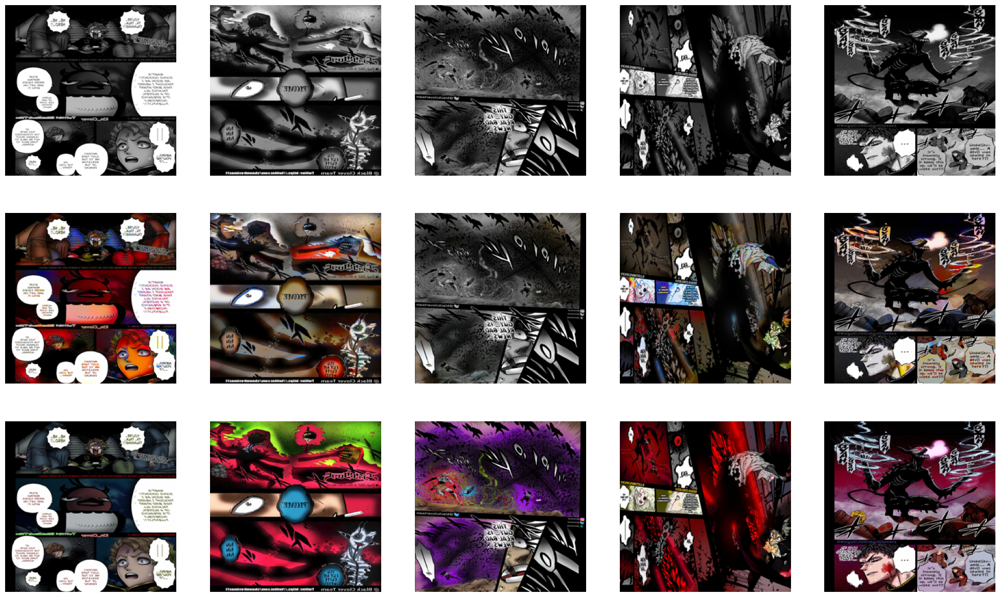

In [24]:
data=next(iter(test_loader))
visualize(model,data)

### FineTune Model

  0%|          | 0/1125 [00:00<?, ?it/s]


Epoch 1/1
Iteration 20/1125
loss_D_fake: 0.55628
loss_D_real: 0.64675
loss_D: 0.60152
loss_G_GAN: 1.16931
loss_G_L1: 7.29741
loss_G: 8.46672


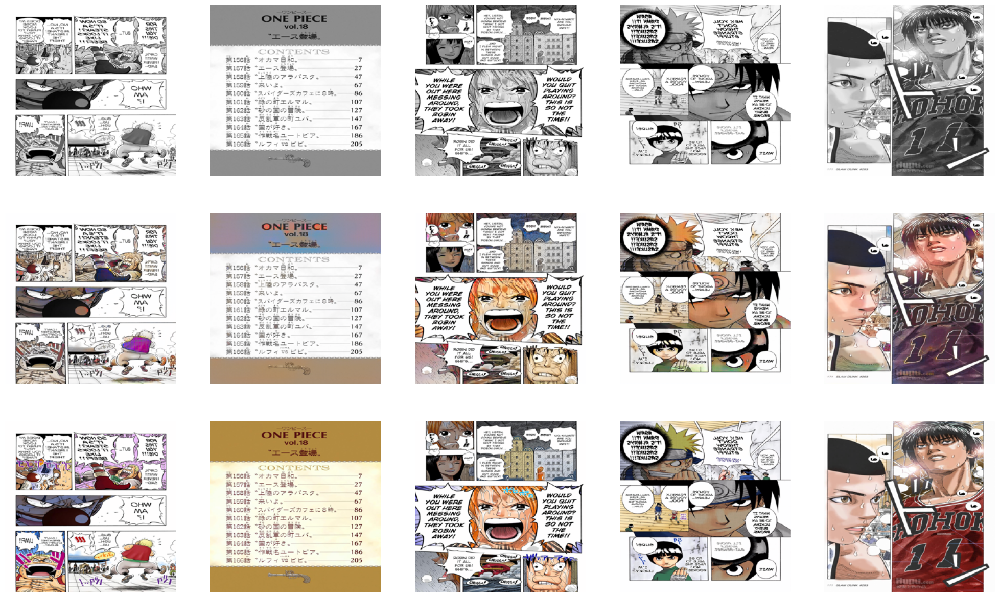


Epoch 1/1
Iteration 40/1125
loss_D_fake: 0.57862
loss_D_real: 0.59628
loss_D: 0.58745
loss_G_GAN: 1.21004
loss_G_L1: 7.52961
loss_G: 8.73965


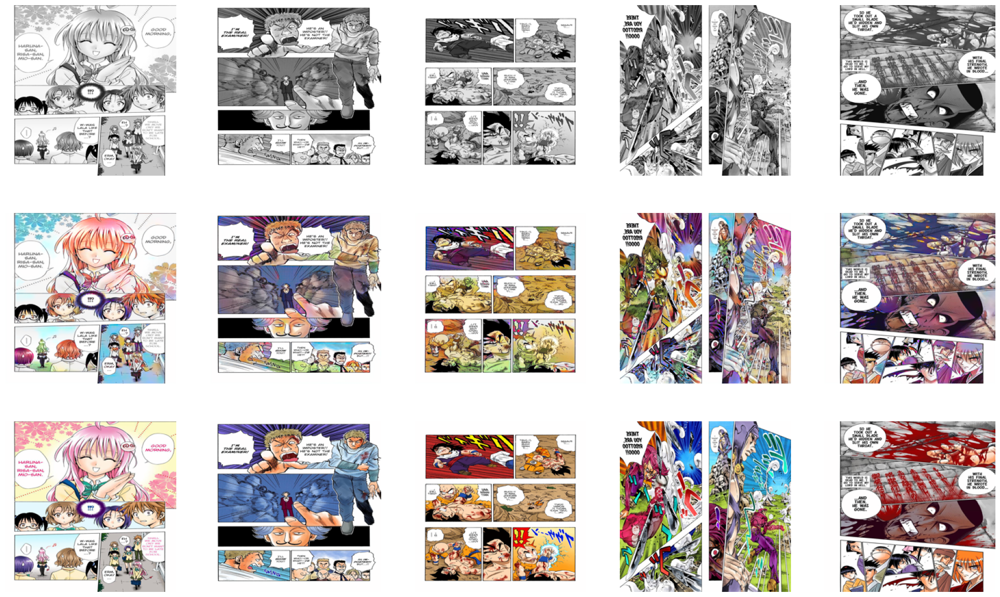


Epoch 1/1
Iteration 60/1125
loss_D_fake: 0.57505
loss_D_real: 0.60712
loss_D: 0.59108
loss_G_GAN: 1.16816
loss_G_L1: 7.52170
loss_G: 8.68985


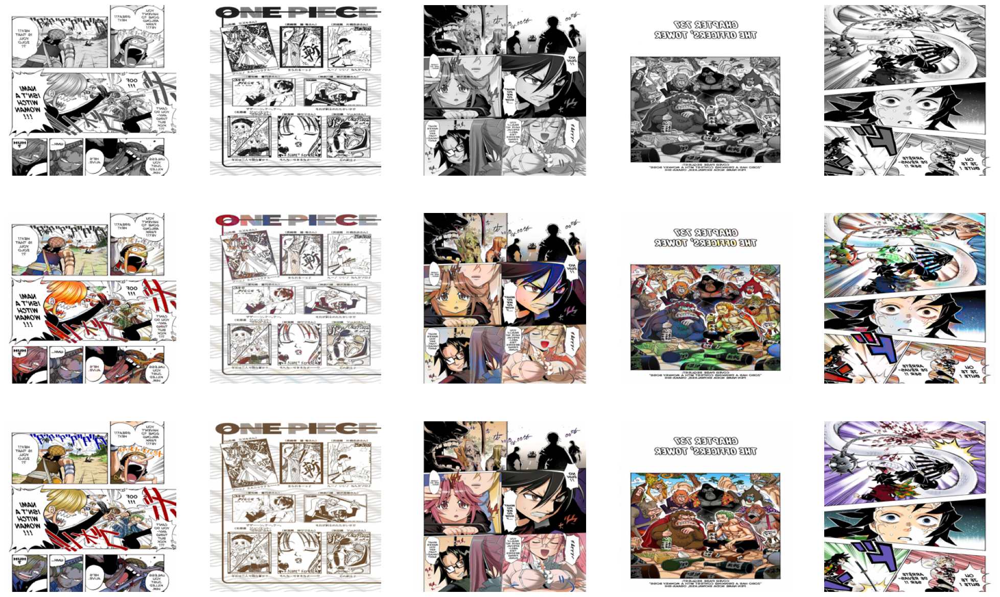


Epoch 1/1
Iteration 80/1125
loss_D_fake: 0.56460
loss_D_real: 0.58577
loss_D: 0.57519
loss_G_GAN: 1.17941
loss_G_L1: 7.65516
loss_G: 8.83457


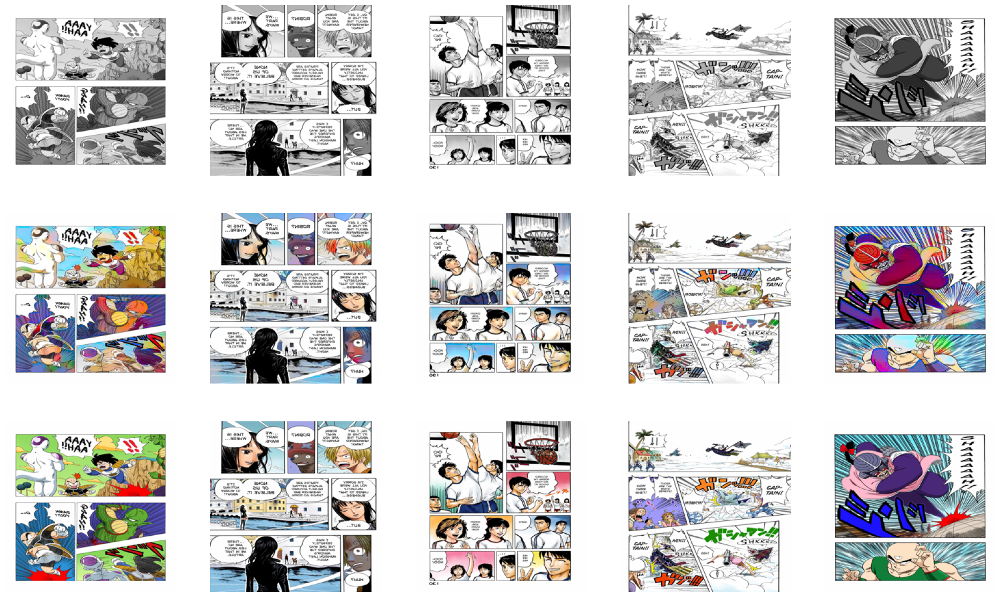


Epoch 1/1
Iteration 100/1125
loss_D_fake: 0.56123
loss_D_real: 0.58228
loss_D: 0.57175
loss_G_GAN: 1.18231
loss_G_L1: 7.74587
loss_G: 8.92818


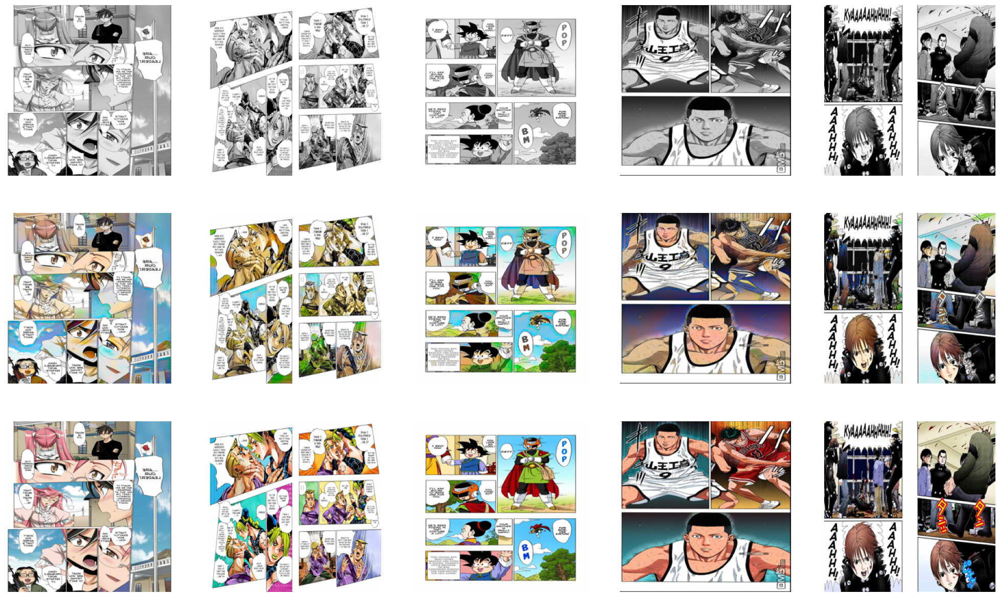


Epoch 1/1
Iteration 120/1125
loss_D_fake: 0.56116
loss_D_real: 0.58705
loss_D: 0.57411
loss_G_GAN: 1.18279
loss_G_L1: 7.80136
loss_G: 8.98415


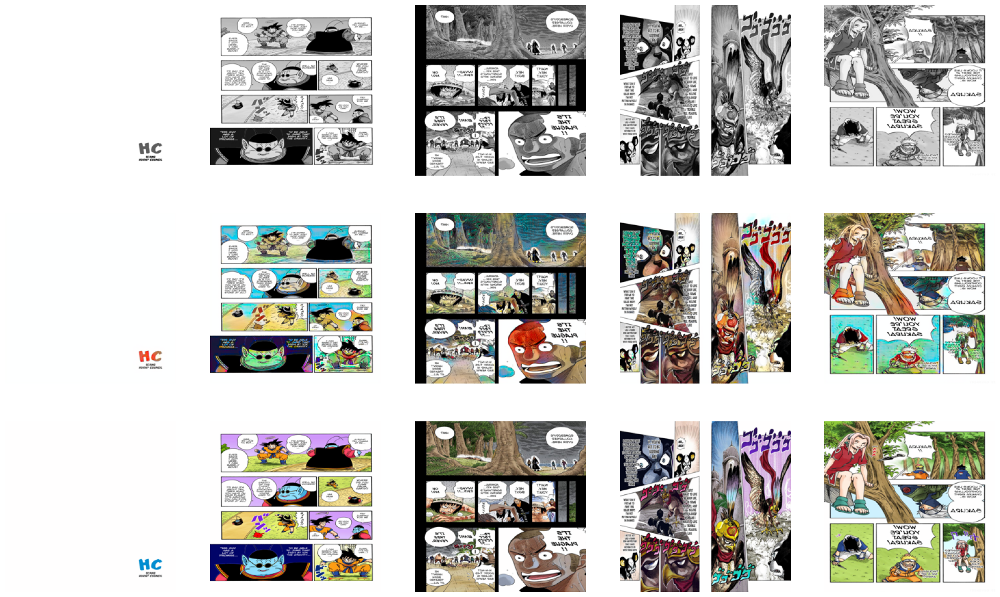


Epoch 1/1
Iteration 140/1125
loss_D_fake: 0.55759
loss_D_real: 0.59216
loss_D: 0.57488
loss_G_GAN: 1.17793
loss_G_L1: 7.86024
loss_G: 9.03817


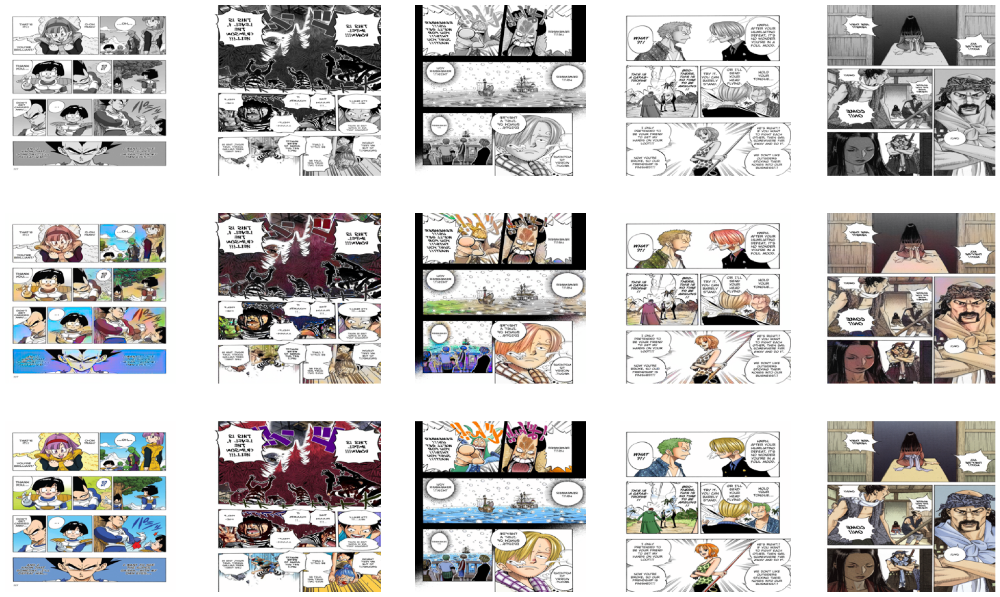


Epoch 1/1
Iteration 160/1125
loss_D_fake: 0.56108
loss_D_real: 0.59490
loss_D: 0.57799
loss_G_GAN: 1.17518
loss_G_L1: 7.83714
loss_G: 9.01232


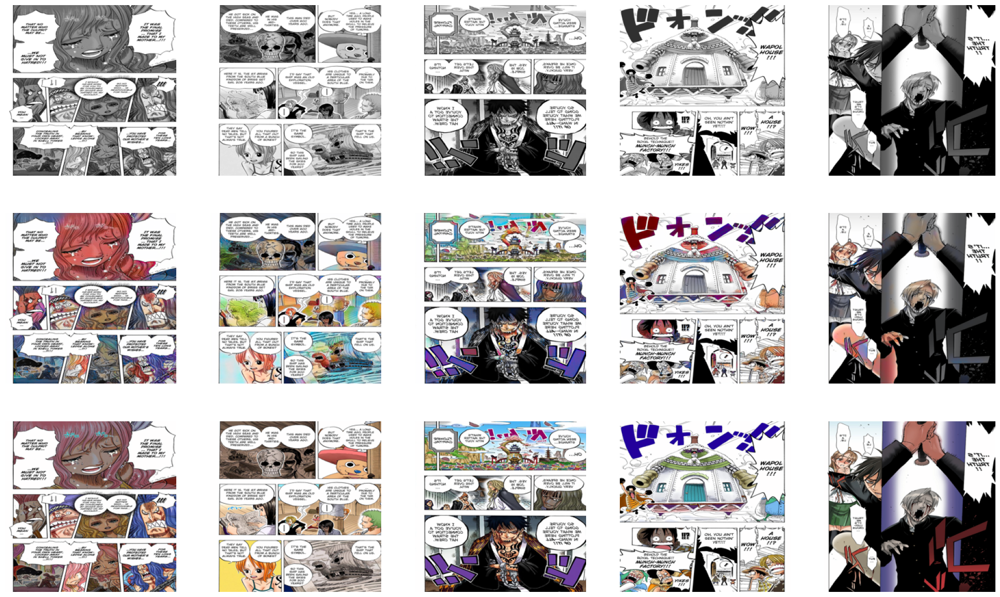

UnidentifiedImageError: cannot identify image file '../Dataset/subset_2/color1//Color 1200431436921056.jpg'

In [26]:
finetune_model(model,train_loader,1,20)

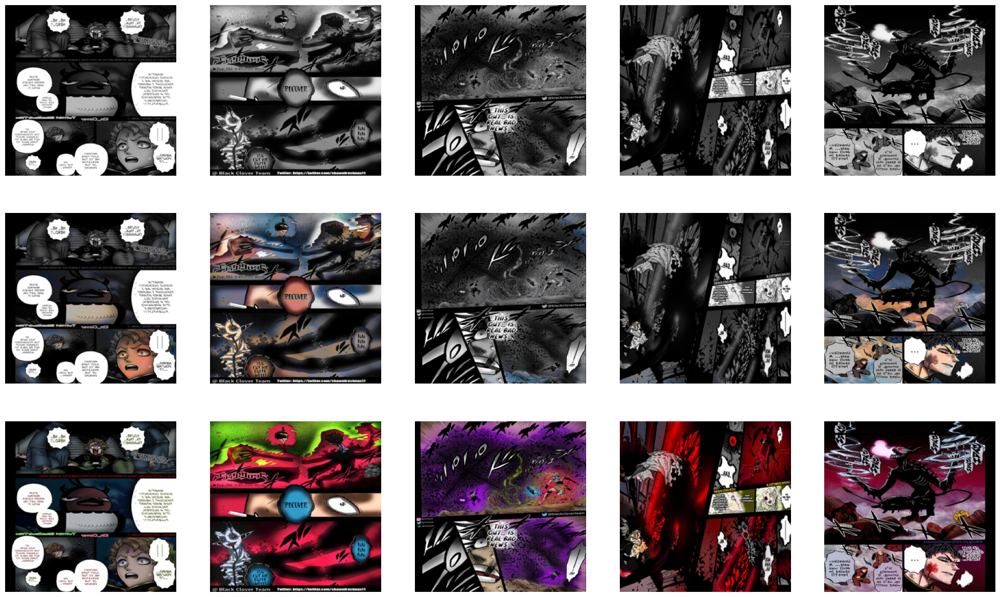

In [64]:
data=next(iter(test_loader))
visualize(model,data)